In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/TNKILC"
)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata_tnkilc = sc.read_h5ad(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_TNKILC_clustering.h5ad"
    )
)

In [5]:
annot_tnkilc = pd.read_csv(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_annotations_TNKILC.txt"
    ),
    header=0,
    sep="\t",
    index_col=0,
)

In [6]:
# these are the cells we need to extract from the raw data to get raw counts
idx2extract = adata_tnkilc[
    adata_tnkilc.obs["Annotation_scVI_detailed"].isin(["NK"])
].obs.index

In [7]:
# re-run scvi etc.. just on NK cells so need raw counts
adata_raw = sc.read_h5ad(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/data_integration/SMC_KUL_Pelka_Che_Wu_CRC_raw.h5ad"
)

In [8]:
# select from the raw data only the barcodes of interest, select raw counts from cell population of interest
adata = adata_raw[adata_raw.obs.index.isin(idx2extract)].copy()
adata.shape

(6361, 38118)

In [9]:
# check that it is raw data
np.max(adata.X)

697.0

### select only patients that have 3 cells 

In [10]:
adata.obs.Patient.value_counts()

COL12      1017
COL18       392
COL17       366
COL07       308
COL16       269
           ... 
C160_T        1
C165_T        1
KUL31         1
KUL30         1
C171_TB       1
Name: Patient, Length: 110, dtype: int64

In [11]:
patient_nbcell_df = adata.obs.Patient.value_counts().reset_index()

In [12]:
patients2keep = patient_nbcell_df[patient_nbcell_df["Patient"] >= 3]["index"]

In [14]:
adata = adata[adata.obs.Patient.isin(patients2keep)].copy()

In [15]:
adata.obs.Patient.value_counts()

COL12         1017
COL18          392
COL17          366
COL07          308
COL16          269
              ... 
SMC21            4
Wu2021_P11       3
C167_T           3
KUL28            3
C169_T           3
Name: Patient, Length: 103, dtype: int64

In [16]:
adata.obs.cell_source.value_counts()

Che      2485
Pelka    2185
SMC      1012
Wu        610
KUL        61
Name: cell_source, dtype: int64

### Normalise + log transform + HVG

Up to this point the data is only available as a count matrix. Counts are representative of molecules that were captured in the scRNA-seq experiment. As not all mRNA molecules in a cell are captured, there is a variability in the total number of counts detected between cells that results from both the number of molecules that were in the cells, and the sampling. As we cannot assume that all cells contain an equal number of molecules (cell sizes can differ substantially), we have to estimate the number of molecules that were initially in the cells. In fact, we don't estimate the exact number of molecules, but instead estimate cell-specific factors that should be proportional to the true number of molecules. These are called size factors. Normalized expression values are calculated by dividing the measured counts by the size factor for the cell.

The basic preprocessing includes assuming all size factors are equal (library size normalization to counts per million - CPM) and log-transforming the count data.


In [17]:
# keep raw
adata.layers["raw"] = adata.X.copy()  # preserve counts

# normalize + log1p
sc.pp.normalize_total(adata, target_sum=1e4, inplace=True)
adata.layers["normalised"] = adata.X.copy()
sc.pp.log1p(adata)

adata.layers["log1p"] = adata.X.copy()

In [18]:
adata.raw = adata  # keep normalised log1p

### HVG 
We extract highly variable genes (HVGs) to further reduce the dimensionality of the dataset and include only the most informative genes. Genes that vary substantially across the dataset are informative of the underlying biological variation in the data. HVGs are used for clustering, trajectory inference, and dimensionality reduction/visualization, while the full data set is used for computing marker genes, differential testing, cell cycle scoring, and visualizing expression values on the data.

**Expects logarithmized data, except when `flavor='seurat_v3'` in which
count data is expected.**

In [19]:
sc.pp.highly_variable_genes(
    adata,
    subset=True,  # subset for integration (but full lognorm data in .raw)
    layer="raw",
    flavor="seurat_v3",
    n_top_genes=2000,
    span=0.3,
    min_disp=0.5,
    min_mean=0.0125,
    max_mean=3,
    # batch_key='cell_source'
)

In [20]:
adata.X.shape

(6353, 2000)

In [21]:
adata.raw.to_adata().X.shape

(6353, 38118)

### scVI
Unless otherwise specified, scvi-tools models require the raw counts (not log library size normalized).

Now it’s time to run setup_anndata(), which alerts scvi-tools to the locations of various matrices inside the anndata. It’s important to run this function with the correct arguments so scvi-tools is notified that your dataset has batches, annotations, etc. For example, if batches are registered with scvi-tools, the subsequent model will correct for batch effects. See the full documentation for details.

In this dataset, there is a “cell_source” categorical covariate, and within each “cell_source”, multiple “patients”. There are also two continuous covariates we’d like to correct for: “percent_mito” and “percent_ribo”. These covariates can be registered using the categorical_covariate_keys argument. If you only have one categorical covariate, you can also use the batch_key argument instead.



In [22]:
scvi.model.SCVI.setup_anndata(
    adata,
    layer="raw",
    categorical_covariate_keys=["cell_source", "Patient"],
    continuous_covariate_keys=[
        "pct_counts_mt",
        "pct_counts_ribo",
    ],  # add cell cycle here if you want to correct for this
)

#### Creating and training a model

In [23]:
model = scvi.model.SCVI(adata)
model

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Not Trained

In [24]:
model.train()

/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (ElboMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 400/400: 100%|██████████| 400/400 [07:09<00:00,  1.07s/it, loss=383, v_num=1]


In [25]:
# save model
model.save(os.path.join(DIR2SAVE, "scvi_NK_model_hvg_mt_ribo"))

In [26]:
# read the model
model = scvi.model.SCVI.load(
    os.path.join(DIR2SAVE, "scvi_NK_model_hvg_mt_ribo"), adata=adata
)  # , use_gpu=True)

INFO     File /data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/TNKILC/scvi_N
         K_model_hvg_mt_ribo/model.pt already downloaded                                     


In [27]:
latent = model.get_latent_representation()  # get model output

In [28]:
latent.shape

(6353, 10)

In [29]:
# It’s often useful to store the outputs of scvi-tools back into the original anndata, as it permits interoperability with
# Scanpy.
adata.obsm["X_scVI"] = latent

In [30]:
# Let’s store the normalized values back in the anndata.
adata.layers["scvi_normalized"] = model.get_normalized_expression(
    adata=adata, library_size=1e4
)

In [31]:
print("Number of PCs:", latent.shape[1])
# use scVI latent space for UMAP generation
# set nb pcs to latent representation shape of scvi
# compute neighbourhood graph
sc.pp.neighbors(
    adata,
    n_neighbors=15,
    n_pcs=latent.shape[1],
    knn=True,
    method="umap",
    metric="euclidean",
    use_rep="X_scVI",
    random_state=7,
)

# compute UMAP embedding
sc.tl.umap(adata, min_dist=0.3, n_components=2, random_state=7)

Number of PCs: 10


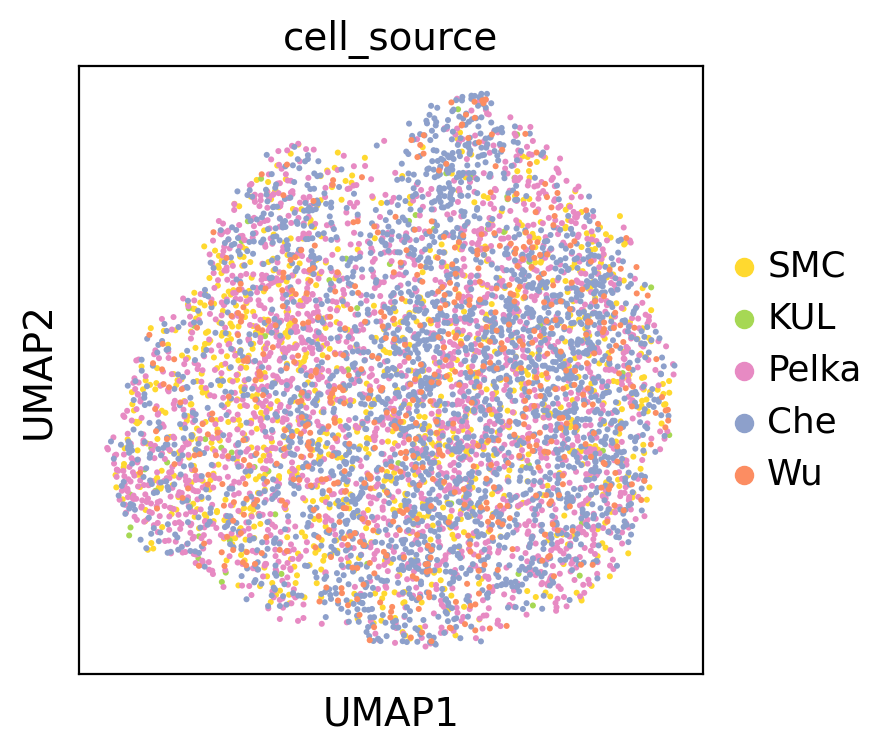

In [32]:
sc.pl.umap(adata, color="cell_source", save="NK_after_integration_scvi.pdf", show=True)

In [33]:
# write to file
adata.write(DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK.h5ad"))

### Clustering

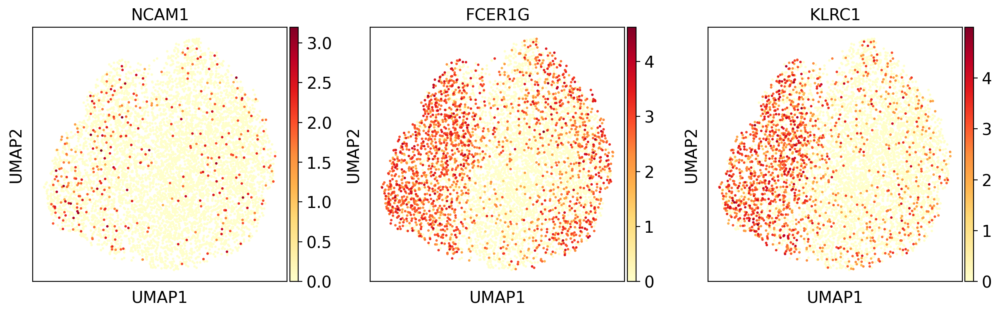

In [35]:
sc.pl.umap(
    adata,
    color=["NCAM1", "FCER1G", "KLRC1"],
    color_map="YlOrRd",
    use_raw=True,
    show=True,
    save="plasma_r.pdf",
)  # NK markers

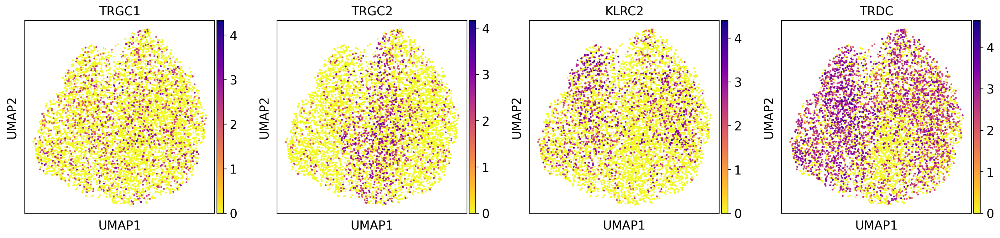

In [36]:
sc.pl.umap(
    adata,
    color=["TRGC1", "TRGC2", "KLRC2", "TRDC"],
    color_map="plasma_r",
    use_raw=True,
    show=True,
    save="dgTmarkers.pdf",
)  # NK markers

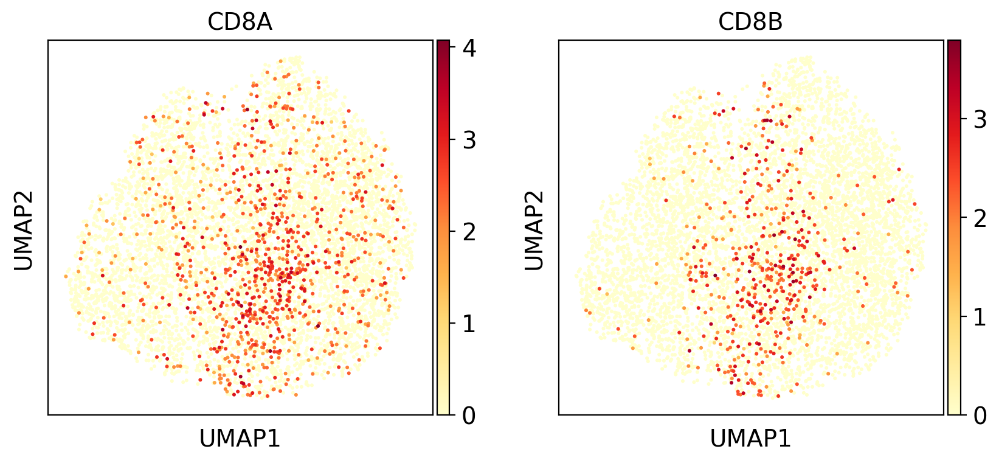

In [37]:
sc.pl.umap(
    adata,
    color=["CD8A", "CD8B"],
    color_map="YlOrRd",
    use_raw=True,
    show=True,
    save="CD8Tmarkers.pdf",
)  # NK markers

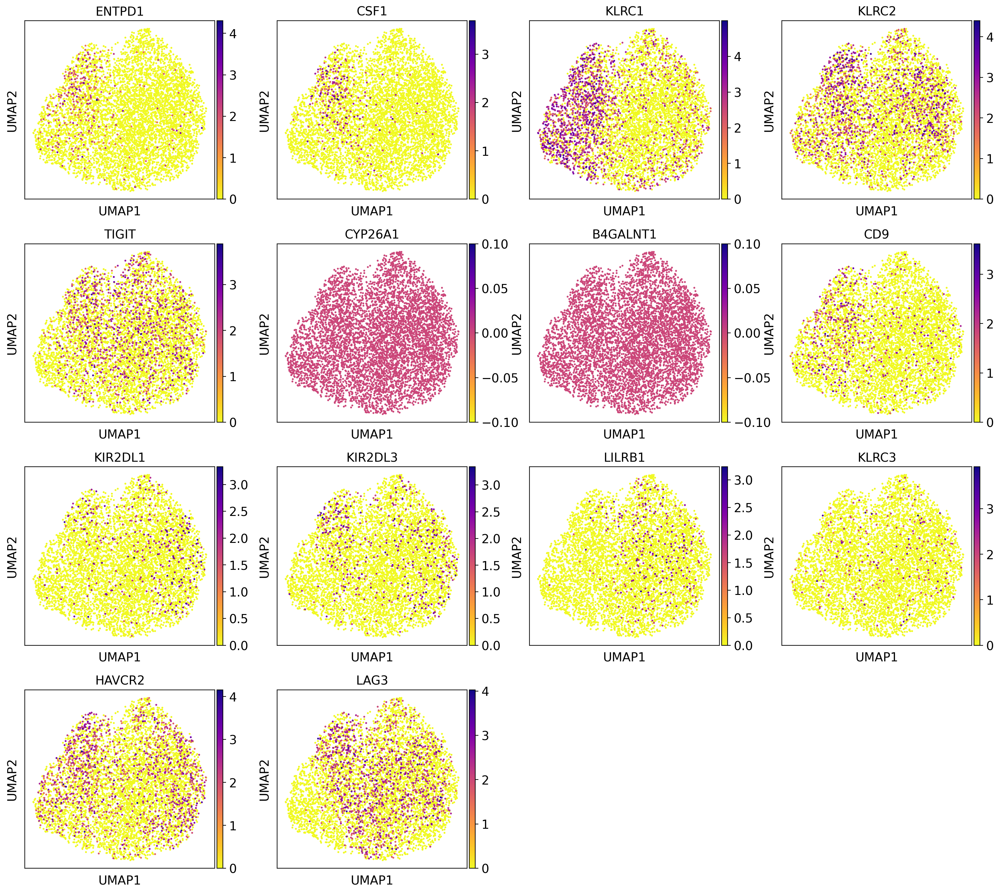

In [46]:
sc.pl.umap(
    adata,
    color=[
        "ENTPD1",
        "CSF1",
        "KLRC1",
        "KLRC2",
        "TIGIT",
        "CYP26A1",
        "B4GALNT1",
        "CD9",
        "KIR2DL1",
        "KIR2DL3",
        "LILRB1",
        "KLRC3",
        "HAVCR2",
        "LAG3",
    ],
    color_map="plasma_r",
    use_raw=True,
)  # paper dNK1, our NK2

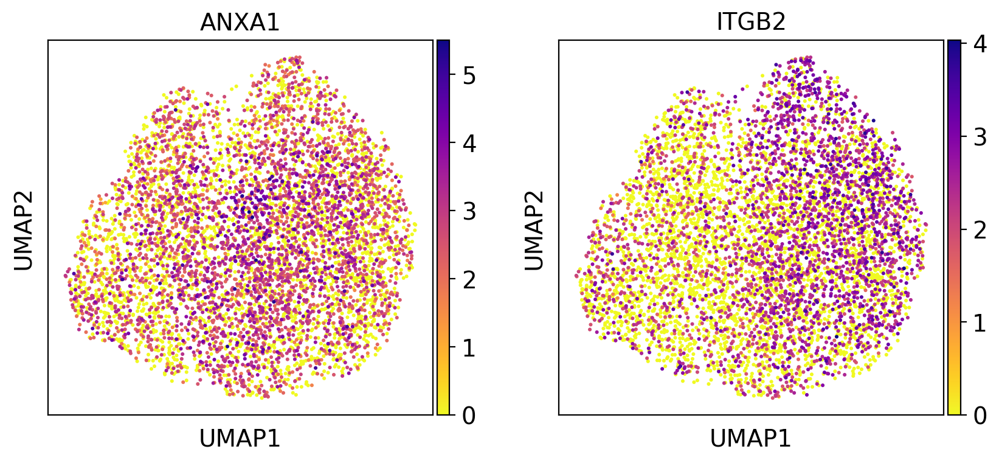

In [39]:
# our NK1, dNK2 in paper
sc.pl.umap(adata, color=["ANXA1", "ITGB2"], color_map="plasma_r", use_raw=True)

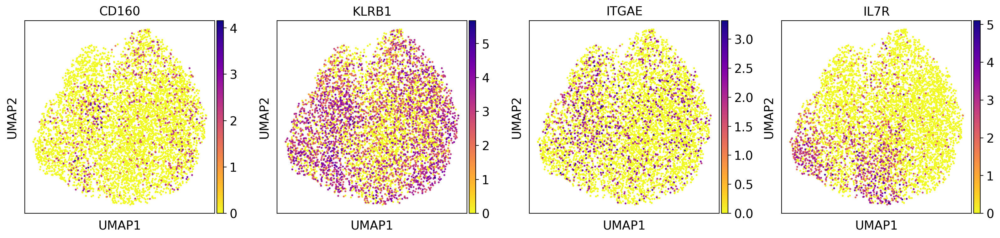

In [40]:
# dNK3 in paper
# CD160, KLRB1 and CD103 (also known as ITGAE), but not the innate lymphocyte cell marker CD127 (also known as IL7R)
sc.pl.umap(
    adata, color=["CD160", "KLRB1", "ITGAE", "IL7R"], color_map="plasma_r", use_raw=True
)

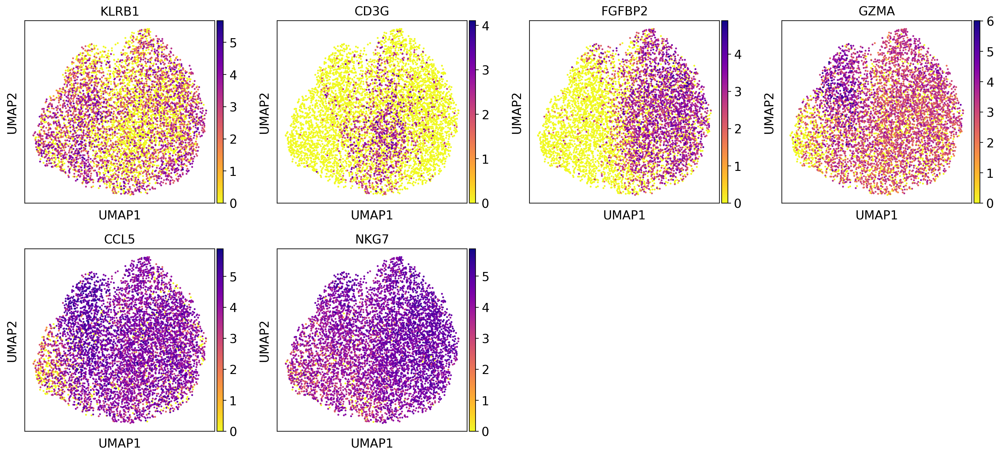

In [41]:
sc.pl.umap(
    adata,
    color=["KLRB1", "CD3G", "FGFBP2", "GZMA", "CCL5", "NKG7"],
    color_map="plasma_r",
    use_raw=True,
    show=True,
    save="NK_NKT_markers.pdf",
)  # NKT markers

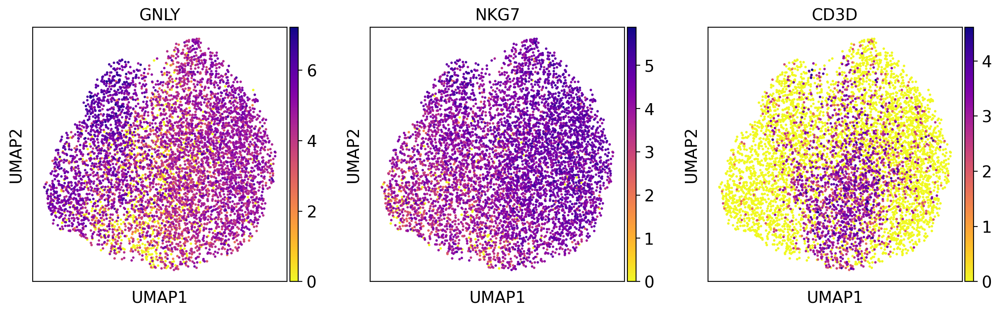

In [42]:
sc.pl.umap(adata, color=["GNLY", "NKG7", "CD3D"], color_map="plasma_r", use_raw=True)
# immature NK, immature natural killer cells which originate from natural killer cell precursors and are committed to mature natural killer cells

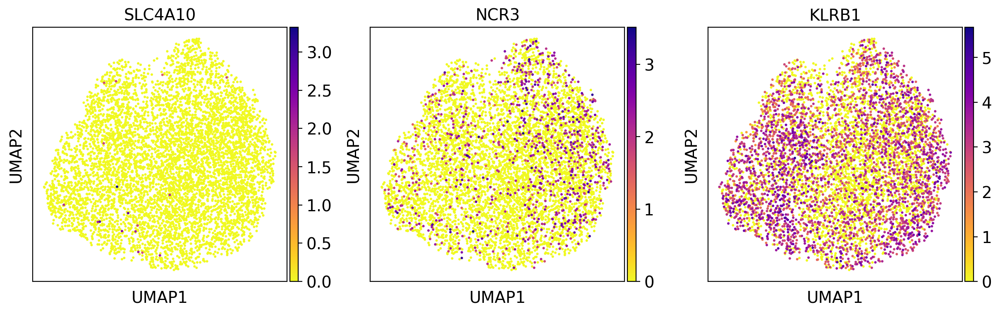

In [43]:
sc.pl.umap(
    adata, color=["SLC4A10", "NCR3", "KLRB1"], color_map="plasma_r", use_raw=True
)  # MAIT

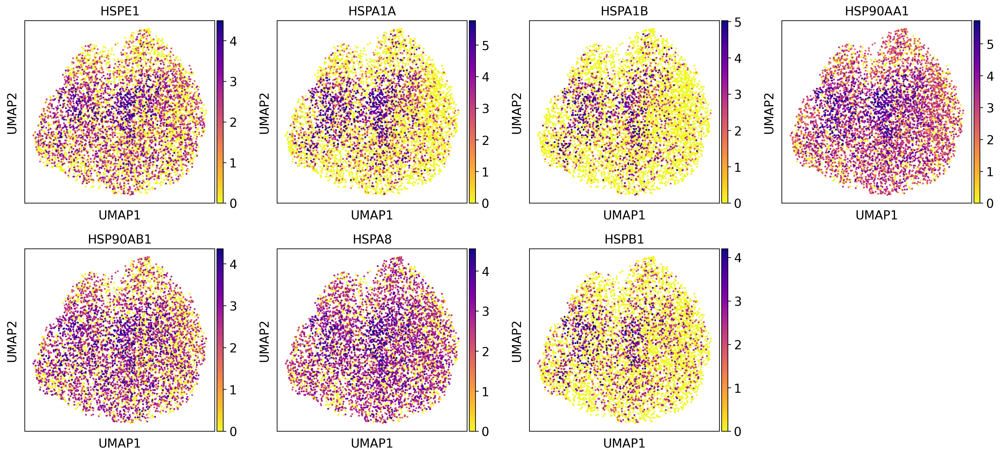

In [44]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="NK_HSPmarkers.pdf",
    show=True,
)

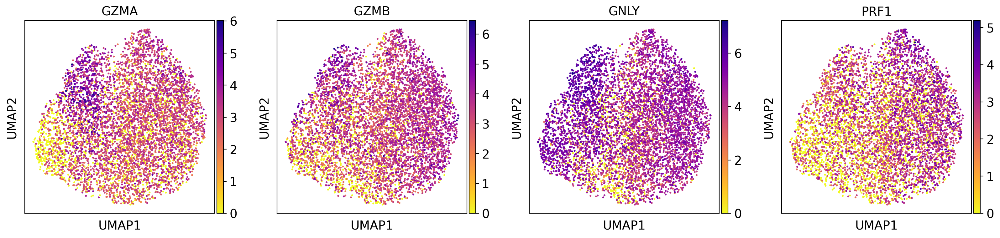

In [45]:
sc.pl.umap(
    adata, color=["GZMA", "GZMB", "GNLY", "PRF1"], color_map="plasma_r", use_raw=True
)

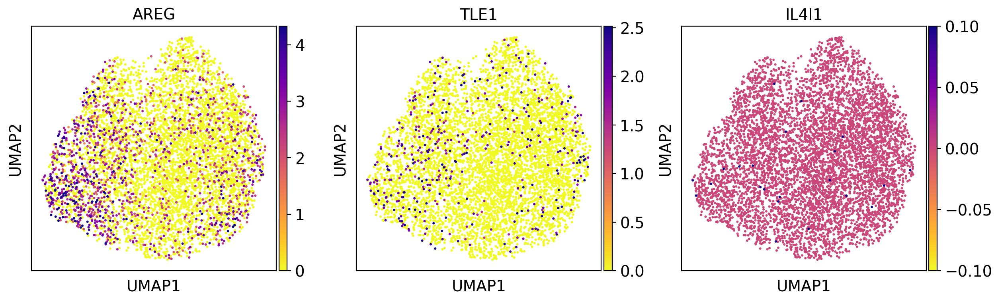

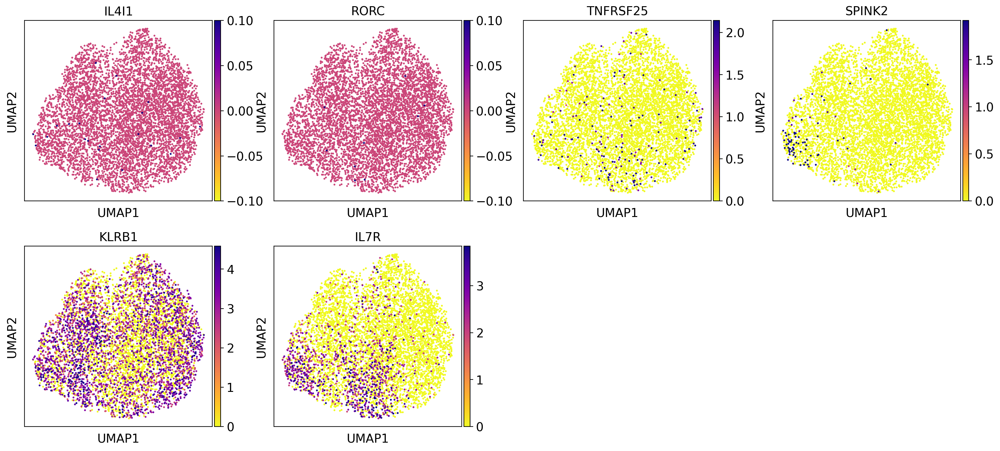

In [48]:
markers_ILC = {
    "ILC": [
        "AREG",
        "TLE1",
        "IL4I1",
    ],  # ['NCR2', 'ITGAE', 'KIT', 'IL7R', 'KLRB1', 'AHR'],
    "ILC1": ["TBX21", "CD3D", "CXCR3", "PLCD4"],
    "ILC2": ["KRT1", "HPGDS", "SLAMF1"],  # ['HPGDS', 'GATA3', 'PTGDR2', 'IL1RL1'],
    "ILC3": ["IL4I1", "RORC", "TNFRSF25", "SPINK2", "KLRB1", "IL7R"],
}

sc.pl.umap(
    adata,
    color=markers_ILC["ILC"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
)

sc.pl.umap(
    adata,
    color=markers_ILC["ILC3"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
)

In [49]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI", resolution=0.5, random_state=7)

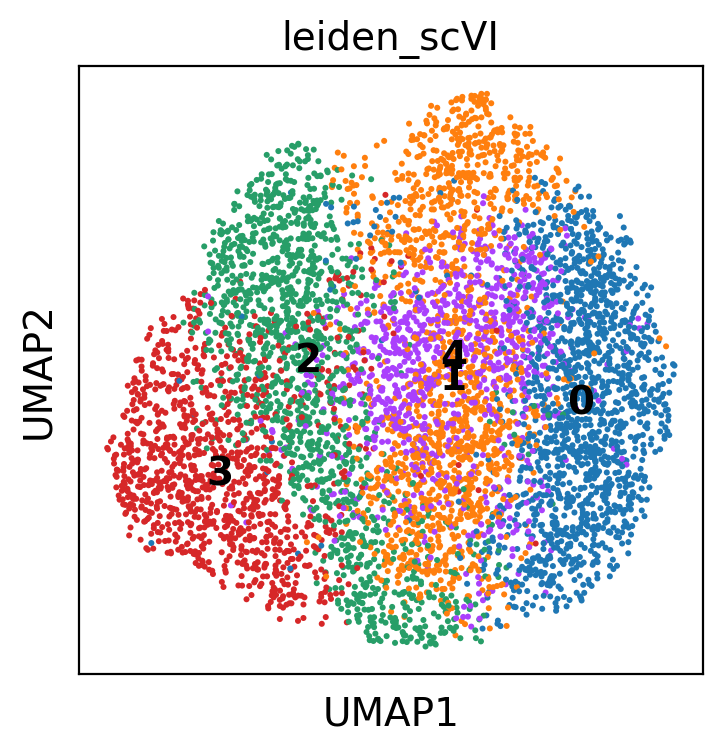

In [50]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    legend_loc="on data",
    save="NK_clustering.pdf",
    show=True,
)

### Differential expression to get DE genes upregulated per cluster 

In [51]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata.uns["log1p"]["base"] = None

In [52]:
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

In [53]:
markers = {
    "NK": ["NCAM1", "FCER1G", "KLRC1"],
    #'immature NK': ['GNLY', 'NKG7', 'CD3D'],
    "NK2": [
        "ENTPD1",
        "CSF1",
        "KLRC1",
        "KLRC2",
        "TIGIT",
        "CYP26A1",
        "B4GALNT1",
        "CD9",
        "KIR2DL1",
        "KIR2DL3",
        "LILRB1",
        "KLRC3",
        "GZMA",
        "GZMB",
        "GNLY",
        "PRF1",
        "HAVCR2",
        "EOMES",
        "IL2RB",
        "ID3",
    ],  # dNK1
    "NK1": ["ANXA1", "ITGB2", "CD9", "CD7", "EOMES", "XCL1", "SELL", "IFITM3"],  # dNK2
    "NK3": [
        "CCL5",
        "CD160",
        "KLRB1",
        "ITGAE",
        "AREG",
        "XCL1",
        "TIGIT",
        "FCGR3A",
        "KLRF1",
        "ITGB2",
        "KLRD1",
    ],  # dNK3
    "NKT": ["KLRB1", "CD3G", "FGFBP2"],
    "HSP": ["HSPE1", "HSPA1A", "HSPA1B", "HSP90AA1", "HSP90AB1", "HSPA8", "HSPB1"],
}

         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: 0, 1, 2, etc.
var_group_labels: NK, NK2, NK1, etc.


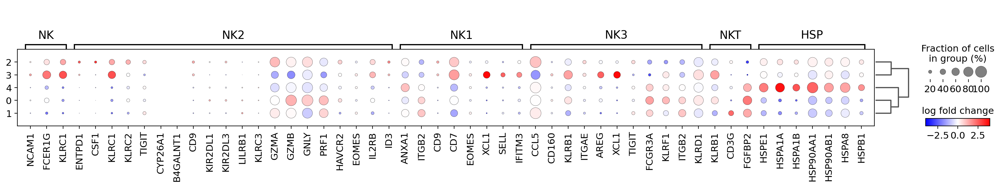

In [54]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="NK_dotplot.pdf",
    show=True,
)

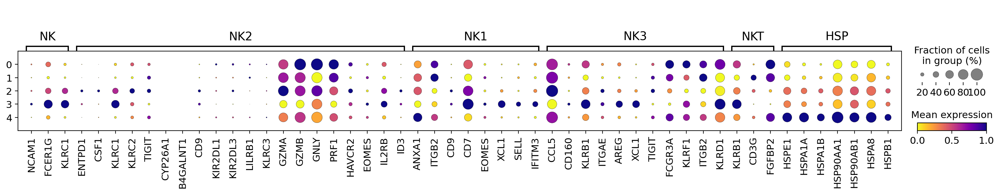

In [55]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="NK_dotplot_mean.pdf",
    show=True,
)

In [56]:
pval_thresh = 0.05
log2fc_thresh = 1
cluster_de_genes = dict()
for cluster in sorted(set(adata.obs["leiden_scVI"])):
    cluster_de_genes[cluster] = sc.get.rank_genes_groups_df(
        adata,
        group=cluster,
        key="rank_genes_wilcoxon",
        pval_cutoff=pval_thresh,
        log2fc_min=log2fc_thresh,
        log2fc_max=None,
    ).sort_values("logfoldchanges", ascending=False)

# write to excel file DE genes per cluster
# Create a Pandas Excel writer using XlsxWriter as the engine.
path2save = DIR2SAVE.joinpath(
    "NK_pval{}_log2fc{}.xlsx".format(pval_thresh, log2fc_thresh)
)

with pd.ExcelWriter(path2save) as writer:
    for cluster in list(cluster_de_genes.keys()):

        # get celltype of cluster
        # celltype = np.unique(adata[adata.obs['leiden']==cluster,:].obs['cell identity'])[0]

        cluster_de_genes[cluster].to_excel(
            writer, sheet_name="cluster{}".format(cluster)
        )

In [57]:
# write to file
adata.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK_clustering.h5ad")
)

### Annotations

In [4]:
# read
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK_clustering.h5ad")
)

In [5]:
adata

AnnData object with n_obs × n_vars = 6353 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'leiden_scVI'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Therapy_colors', 'Tissue_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_sou

In [6]:
old_to_new = {
    "0": "NK2",  # GZMB, PRF1
    "1": "NKT",  # because it has CD3G, FGFBP2, TRAC
    "2": "NK2",  # CSF1, ENTPD1, LAG3,
    "3": "NK1",  # XCL1, KLRC1, AREG, XCL2, SELL, CD7, KRT81, KRT86, KLRB1
    "4": "HSP",
}

In [7]:
adata.obs["Annotation_scVI_detailed"] = (
    adata.obs["leiden_scVI"].map(old_to_new).astype("category")
)

In [8]:
adata.obs["Annotation_scVI_detailed"].cat.categories

Index(['HSP', 'NK1', 'NK2', 'NKT'], dtype='object')

In [9]:
adata.uns["Annotation_scVI_detailed_colors"] = [
    "#969696",
    "#1d91c0",
    "#dd3497",
    "#a6cee3",
]

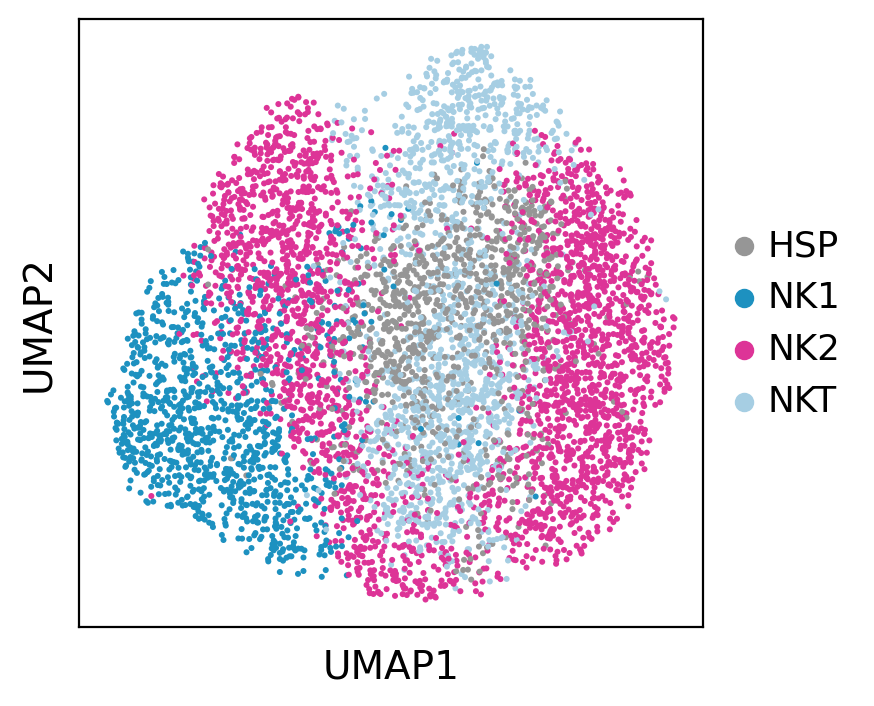

In [10]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed",
    show=True,
    legend_loc="right margin",
    save="NKannotations.pdf",
    title="",
)

In [11]:
# save intermediate result
# write to file
adata.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK_clustering.h5ad")
)

# write csv of annotations
adata.obs["Annotation_scVI_detailed"].to_csv(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_annotations_NK.txt"
    ),
    sep="\t",
    index=True,
    header=True,
)

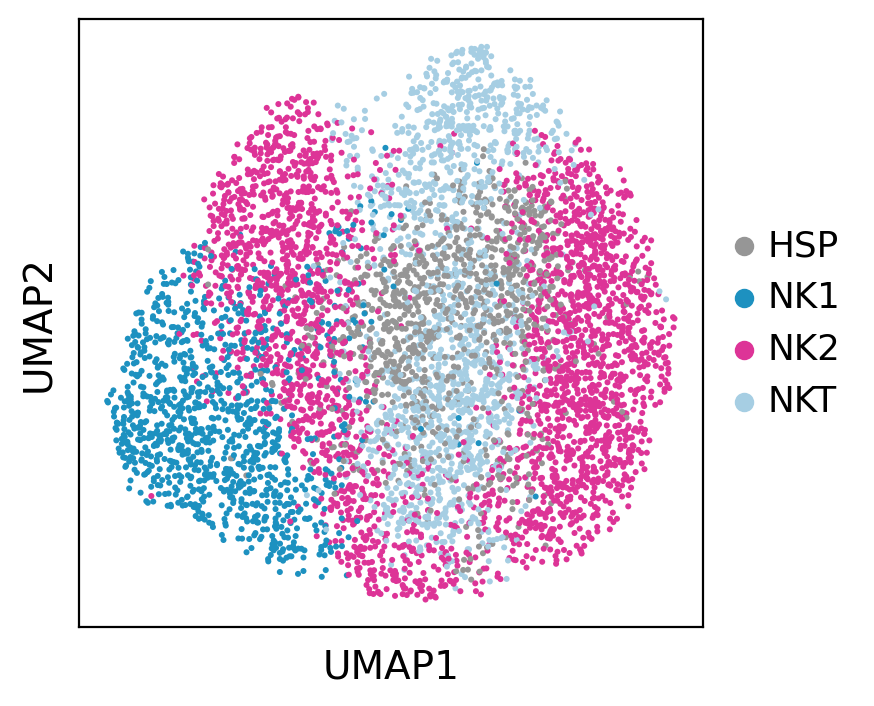

In [13]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed",
    save="NK_annotations.pdf",
    show=True,
    title="",
)

From old clustering
* Cluster 3: NK1 has SPINK2, XCL1, SELL, KLRC1, XCL2, AREG, IL7R, KRT81, KRT86, GZMK, CD7, NCAM1, IL2RB
* cluster 2: NK2 is dNK1 in paper mirjana has CSF1, ITGA1, ENTPD1, KRT86, KRT81, GZMK, KIR2DL4, KLRC1, CD9, GZMA, IL2RB, HAVCR2, GNLY
* Cluster 0: FCGR3A, GZMB, KLRF1, CCL3
* Cluster 1: NKT
* Cluster 5: dNK3 maybe? FCGR3A, CX3CR1, KLRG1, ITGB2, KLRF1, PRF1, GZMH, KLRD1

**Single-cell reconstruction of the early maternal–fetal interface in humans**

dNK1 contains more cytoplasmic granules than dNK2 and dNK3, which is consistent with our scRNA-seq data that show higher levels of expression of PRF1, GNLY, GZMA and GZMB RNA in this subset (Fig. 4e). Higher levels of expression of the granule proteins (PRF1, GNLY, GZMA and GZMB) are found in KIR+ compared to KIR− dNK cells by flow cytometry (Fig. 4f). dNK1 cells also express high levels of enzymes involved in glycolysis (Fig. 4g). Thus, dNK1 cells are characterized by active glycolytic metabolism, and show higher expression of KIR genes (KIR2DS1, KIR2DS4, KIR2DL1, KIR2DL2 and KIR2DL3), LILRB1 and cytoplasmic granule proteins, suggesting that it is dNK1 cells that particularly interact with EVT.

dNK1 cells express higher levels of CSF1, the receptor of which (CSF1R) is expressed by EVT and macrophages (Fig. 5a, b). Secretion of CSF1 by dNK cells and interaction with the CSF1R on EVT have previously been described28,29, and we now pinpoint this interaction specifically to the dNK1 subset. By contrast, dNK2 and dNK3 express high levels of XCL1, and CCL5 is highly expressed by dNK3 (Fig. 5a, b, Extended Data Fig. 9b). CCR1, the receptor for CCL5, is expressed by EVT, which suggests a role for dNK3 in regulating EVT invasion30. The expression pattern of the XCL1–XCR1 ligand–receptor complex suggests functional interactions between dNK2 and dNK3 and both EVT and conventional DC1 (labelled as DC1). DC1 recruitment, which is mediated by natural killer cells, occurs in tumour microenvironments31. 

### Check annotations

In [14]:
# read
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_NK_clustering.h5ad")
)

In [15]:
### read some signatures from zhang paper 2022
# read excel file
nk_phen_zhang = pd.read_excel(
    "/data/BCI-CRC/nasrine/data/zhang_signatures.xlsx",
    sheet_name="NK_markers",
    skiprows=None,
    header=0,
    dtype=str,
)

In [16]:
set(nk_phen_zhang.Cluster)

{'c59_NK-FCGR3A',
 'c60_NK-SELL',
 'c61_NK-FCGR3A|IFNG',
 'c62_NK-DUSP4',
 'c63_NK-CD160',
 'c64_NK-CD160|IFNG',
 'c65_NK-CD160|ICAM1',
 'c66_NK-MKI67',
 'c67_NK-IL7R'}

387


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


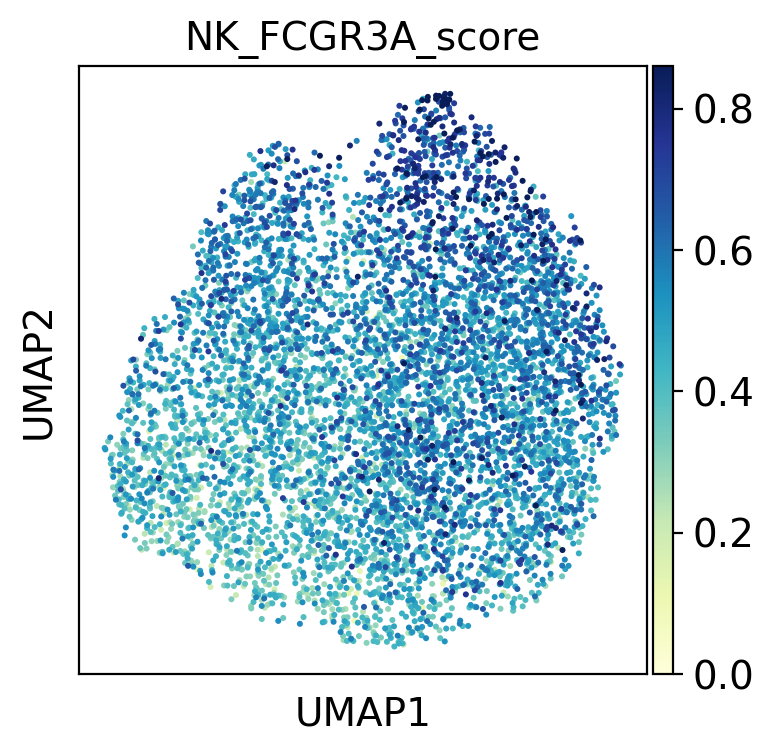

length of gene list in adata.var: 382


In [17]:
NK_FCGR3A_signature = nk_phen_zhang[
    nk_phen_zhang["Cluster"].str.contains("c59_NK-FCGR3A")
]["Gene"].values.tolist()
print(len(NK_FCGR3A_signature))
NK_FCGR3A_signature_var = [
    gene for gene in NK_FCGR3A_signature if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=NK_FCGR3A_signature_var, score_name="NK_FCGR3A_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="NK_FCGR3A_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="TNKILC_NK_FCGR3A_score.pdf",
    color_map="YlGnBu",
    show=True,
)
print("length of gene list in adata.var:", len(NK_FCGR3A_signature_var))

294


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


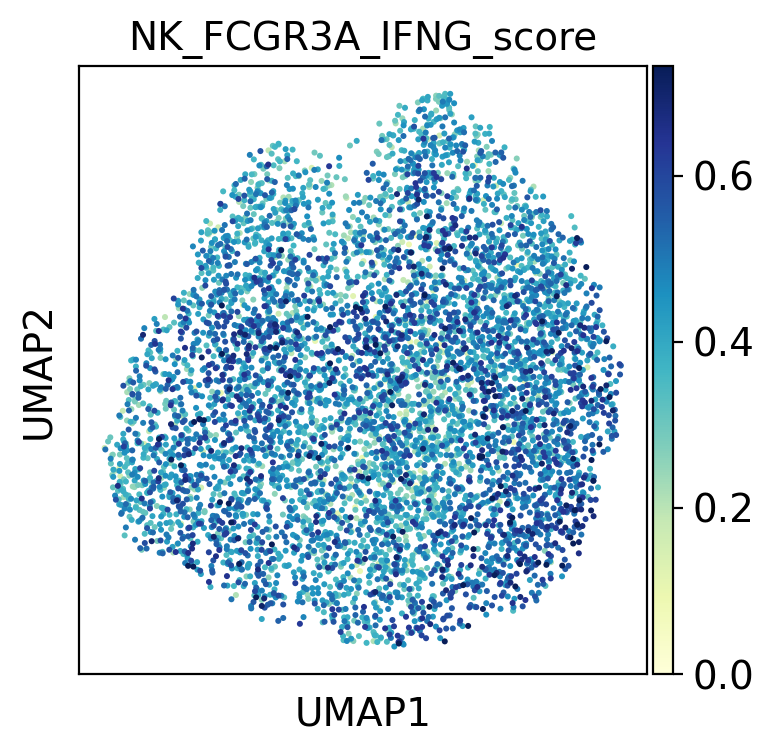

length of gene list in adata.var: 294


In [18]:
NK_FCGR3A_IFNG_signature = nk_phen_zhang[
    nk_phen_zhang["Cluster"].str.contains("c61_NK-FCGR3A|IFNG")
]["Gene"].values.tolist()
print(len(NK_FCGR3A_IFNG_signature))
NK_FCGR3A_IFNG_signature = [
    gene for gene in NK_FCGR3A_IFNG_signature if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata,
    gene_list=NK_FCGR3A_IFNG_signature,
    score_name="NK_FCGR3A_IFNG_score",
    use_raw=True,
)
sc.pl.umap(
    adata,
    color="NK_FCGR3A_IFNG_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="TNKILC_NK_FCGR3A-IFNG_score.pdf",
    color_map="YlGnBu",
    show=True,
)
print("length of gene list in adata.var:", len(NK_FCGR3A_IFNG_signature))

203


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


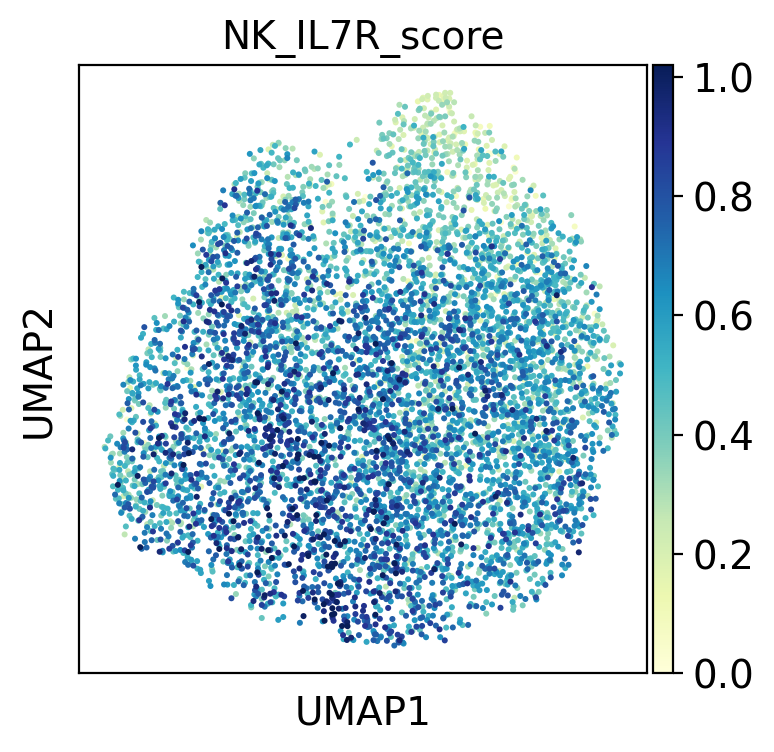

length of gene list in adata.var: 199


In [19]:
NK_IL7R_signature = nk_phen_zhang[nk_phen_zhang["Cluster"].str.contains("c67_NK-IL7R")][
    "Gene"
].values.tolist()
print(len(NK_IL7R_signature))
NK_IL7R_signature = [
    gene for gene in NK_IL7R_signature if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=NK_IL7R_signature, score_name="NK_IL7R_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="NK_IL7R_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="TNKILC_NK_FCGR3A-IFNG_score.pdf",
    color_map="YlGnBu",
    show=True,
)
print("length of gene list in adata.var:", len(NK_IL7R_signature))